In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# install dependencies: (use cu101 because colab has CUDA 10.1)
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
     |████████████████████████████████| 703.8 MB 22 kB/s 
     |████████████████████████████████| 6.6 MB 63.2 MB/s 
  Attempting uninstall: torch
    Found existing installation: torch 1.9.0+cu102
    Uninstalling torch-1.9.0+cu102:
      Successfully uninstalled torch-1.9.0+cu102
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.10.0+cu102
    Uninstalling torchvision-0.10.0+cu102:
      Successfully uninstalled torchvision-0.10.0+cu102
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
torchtext 0.10.0 requires torch==1.9.0, but you have torch 1.5.0+cu101 which is incompatible.
     |████████████████████████████████| 274 kB 8.3 MB/s 
  Created wheel for pyyaml: filename=PyYAML-5.1-cp37-cp37m-linux_x86_64.whl size=44092 sha256=dd7ffd13d3fba96f3d017725d80c71

In [ ]:
# install detectron2:
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html

Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2 MB 1.9 MB/s 
     |████████████████████████████████| 49 kB 3.5 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20210812-py3-none-any.whl size=60666 sha256=96b48cc6d109856ad885b797b0b7dd7b91111dc5be01692e17e0dd8340d1384a
  Stored in directory: /root/.cache/pip/wheels/96/b3/60/5dd98f4458841d2c07395a99e2d7f4260b5a320e4aebb683d1
Successfully built fvcore


In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

Import cones data


In [1]:
# !unzip '/content/drive/My Drive/yolov/json_dataset.zip' -d '/content/drive/My Drive/yolov/'

In [ ]:
from detectron2.data.datasets import register_coco_instances
register_coco_instances("train", {}, "/content/drive/My Drive/yolov/json_dataset/train/images/_annotations.coco.json", "/content/drive/My Drive/yolov/json_dataset/train/images")
register_coco_instances("val", {}, "/content/drive/My Drive/yolov/json_dataset/val/images/_annotations.coco.json", "/content/drive/My Drive/yolov/json_dataset/val/images")
register_coco_instances("test", {}, "/content/drive/My Drive/yolov/json_dataset/test/images/_annotations.coco.json", "/content/drive/My Drive/yolov/json_dataset/test/images")

WARNING [08/18 16:00:48 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/18 16:00:48 d2.data.datasets.coco]: Loaded 5483 images in COCO format from /content/drive/My Drive/yolov/json_dataset/train/images/_annotations.coco.json


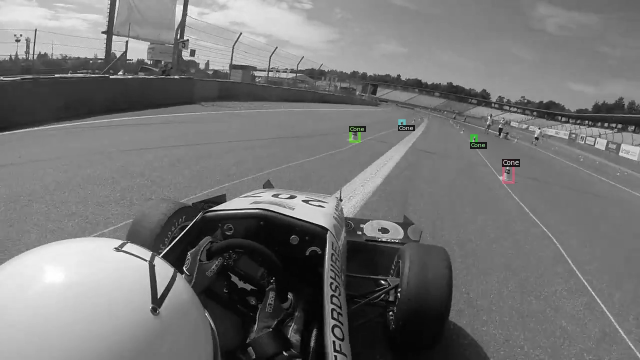

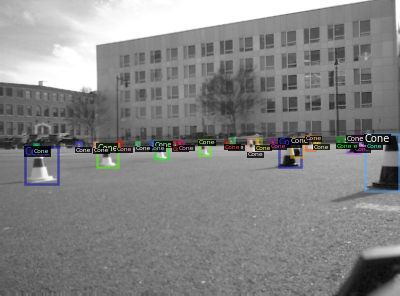

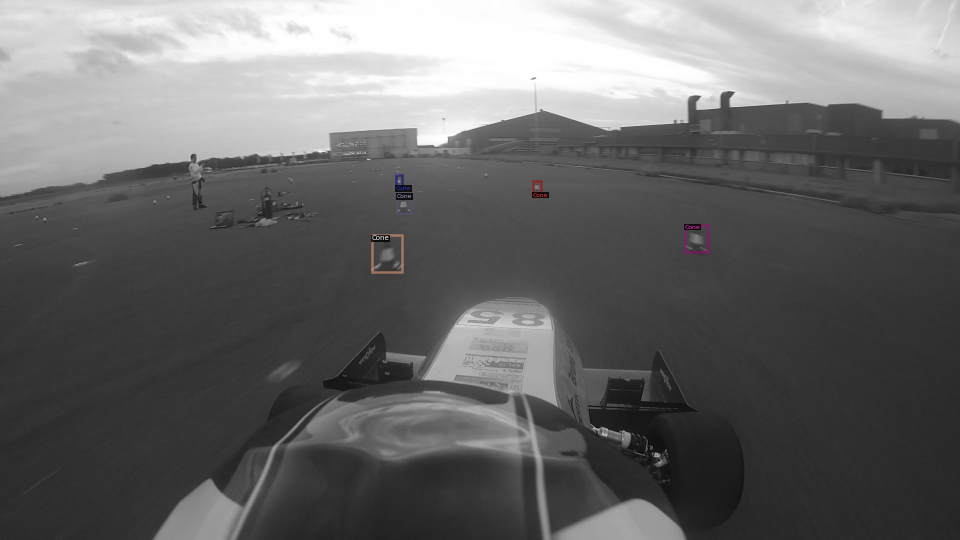

In [ ]:
#visualize training data
my_dataset_train_metadata = MetadataCatalog.get("train")
dataset_dicts = DatasetCatalog.get("train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

In [ ]:
#We are importing our own Trainer Module here to use the COCO validation evaluation during training. Otherwise no validation eval occurs.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
#from .detectron2.tools.train_net import Trainer
#from detectron2.engine import DefaultTrainer
# select from modelzoo here: https://github.com/facebookresearch/detectron2/blob/master/MODEL_ZOO.md#coco-object-detection-baselines

from detectron2.config import get_cfg
#from detectron2.evaluation.coco_evaluation import COCOEvaluator
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("train",)
cfg.DATASETS.TEST = ("val",)

cfg.DATALOADER.NUM_WORKERS = 4
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 4
cfg.SOLVER.BASE_LR = 0.001

cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500 #adjust up if val mAP is still rising, adjust down if overfit
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05

cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 

cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[08/18 16:48:00 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, we

[08/18 16:48:01 d2.engine.train_loop]: Starting training from iteration 0
[08/18 16:49:04 d2.utils.events]:  eta: 1:18:18  iter: 19  total_loss: 2.034  loss_cls: 0.713  loss_box_reg: 0.769  loss_rpn_cls: 0.380  loss_rpn_loc: 0.244  time: 3.1724  data_time: 0.0352  lr: 0.000020  max_mem: 12058M
[08/18 16:50:09 d2.utils.events]:  eta: 1:18:10  iter: 39  total_loss: 1.769  loss_cls: 0.633  loss_box_reg: 0.792  loss_rpn_cls: 0.104  loss_rpn_loc: 0.224  time: 3.2182  data_time: 0.0111  lr: 0.000040  max_mem: 12058M
[08/18 16:51:18 d2.utils.events]:  eta: 1:19:19  iter: 59  total_loss: 1.581  loss_cls: 0.540  loss_box_reg: 0.777  loss_rpn_cls: 0.055  loss_rpn_loc: 0.198  time: 3.2957  data_time: 0.0097  lr: 0.000060  max_mem: 12058M
[08/18 16:52:26 d2.utils.events]:  eta: 1:18:53  iter: 79  total_loss: 1.515  loss_cls: 0.476  loss_box_reg: 0.789  loss_rpn_cls: 0.042  loss_rpn_loc: 0.217  time: 3.3153  data_time: 0.0098  lr: 0.000080  max_mem: 12058M
[08/18 16:53:34 d2.utils.events]:  eta: 1:

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
# test evaluation
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [08/18 19:14:31 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[08/18 19:14:31 d2.data.datasets.coco]: Loaded 781 images in COCO format from /content/drive/My Drive/yolov/json_dataset/test/images/_annotations.coco.json
[08/18 19:14:31 d2.data.common]: Serializing 781 elements to byte tensors and concatenating them all ...
[08/18 19:14:31 d2.data.common]: Serialized dataset takes 0.43 MiB
[08/18 19:14:31 d2.evaluation.evaluator]: Start inference on 781 images
[08/18 19:14:34 d2.evaluation.evaluator]: Inference done 11/781. 0.2399 s / img. ETA=0:03:05
[08/18 19:14:39 d2.evaluation.evaluator]: Inference done 32/781. 0.2403 s / img. ETA=0:03:01
[08/18 19:14:44 d2.evaluation.evaluator]: Inference done 52/781. 0.2439 s / img. ETA=0:02:59
[08/18 19:14:49 d2.evaluation.evaluator]: Inference done 73/781. 0.2440 s / img. ETA=0:02:54
[08/18 19:14:55 d2.evaluation.evaluator]: Inference done 94/781. 0.2452 s / img. ETA=0:02:

OrderedDict([('bbox',
              {'AP': 48.65608267367713,
               'AP50': 87.55356736842253,
               'AP75': 49.25011224726897,
               'APl': 71.02326353182161,
               'APm': 63.68445991273026,
               'APs': 39.37448385094883})])

In [ ]:
%ls ./output/

coco_instances_results.json                       last_checkpoint
events.out.tfevents.1629302464.0ceb995d1a17.75.0  metrics.json
events.out.tfevents.1629305281.0ceb995d1a17.75.1  model_final.pth
instances_predictions.pth


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7   # set the testing threshold 
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("test")

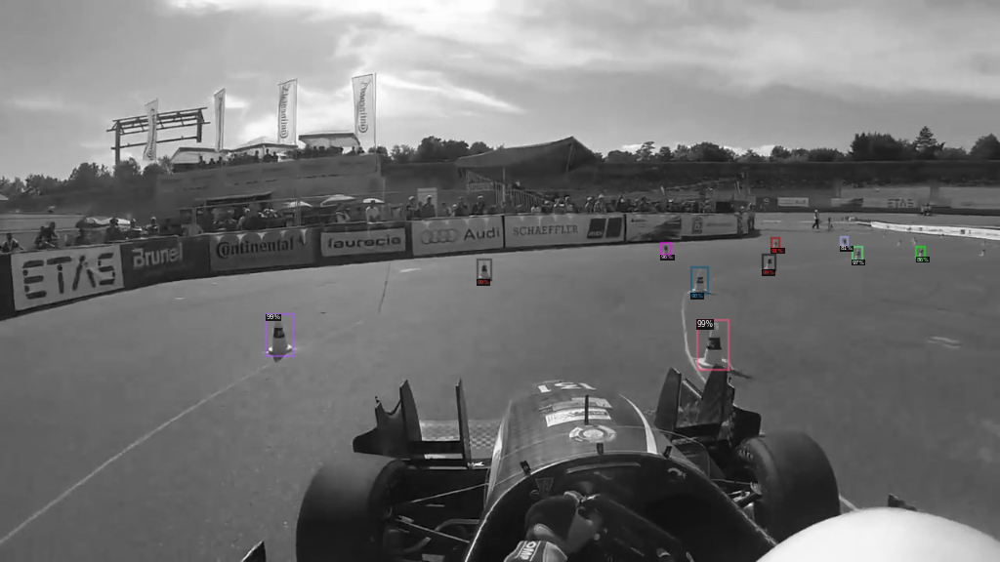

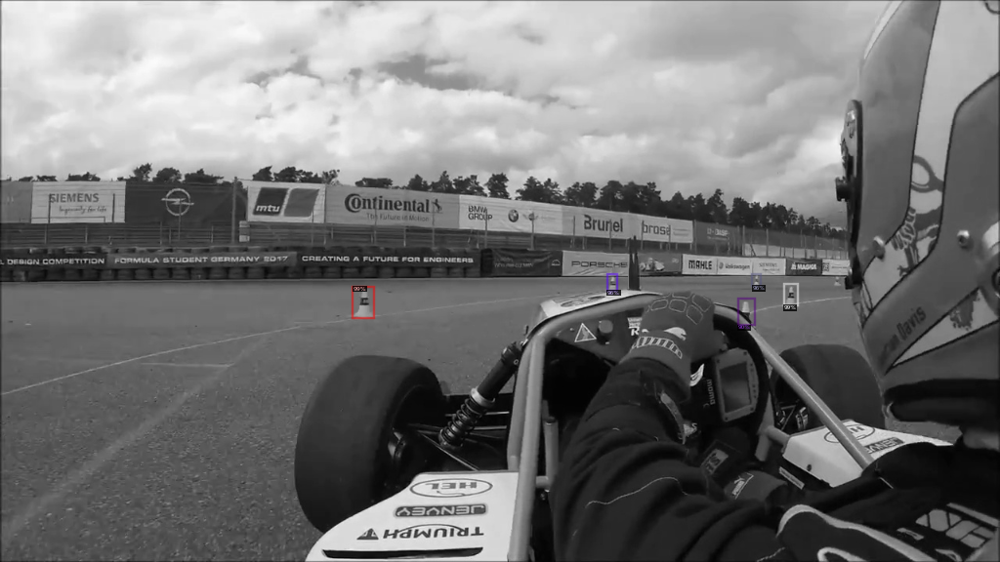

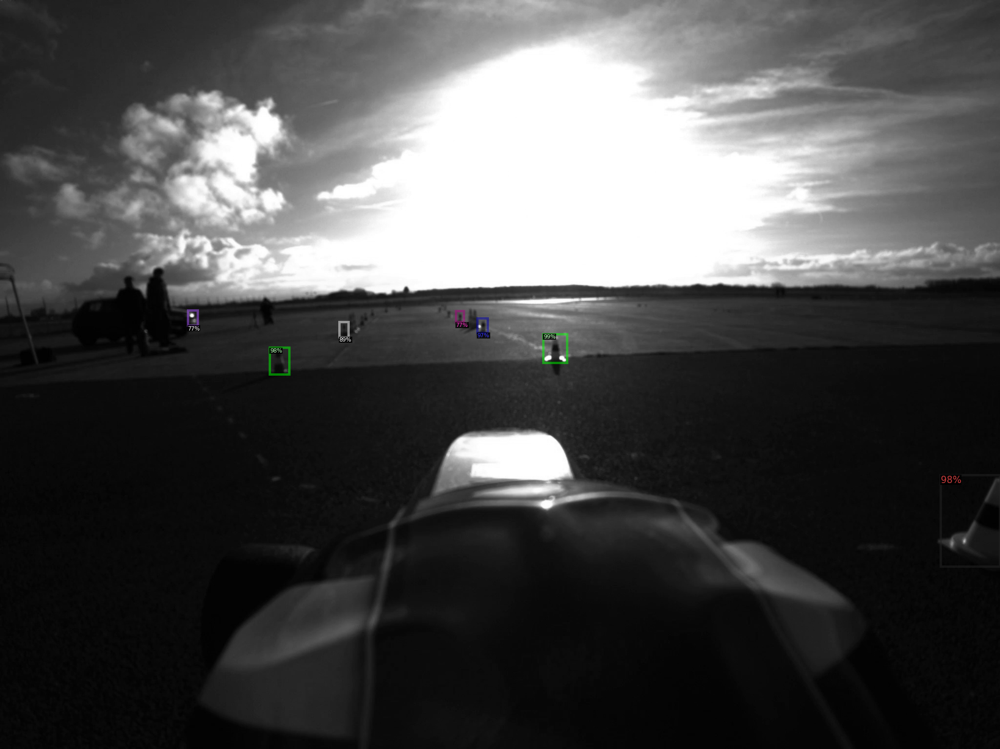

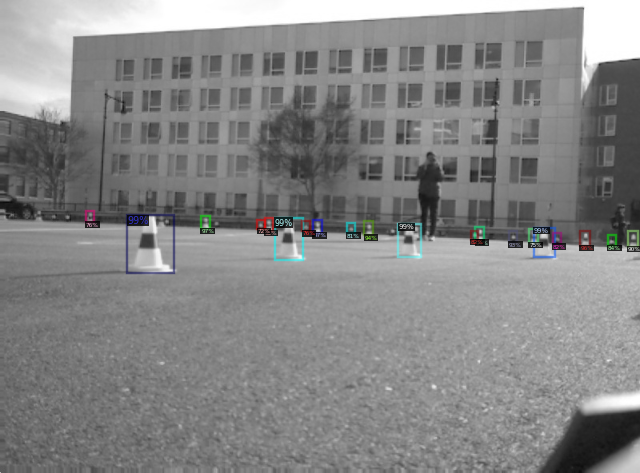

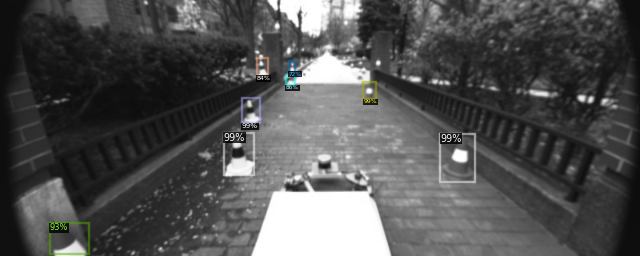

...

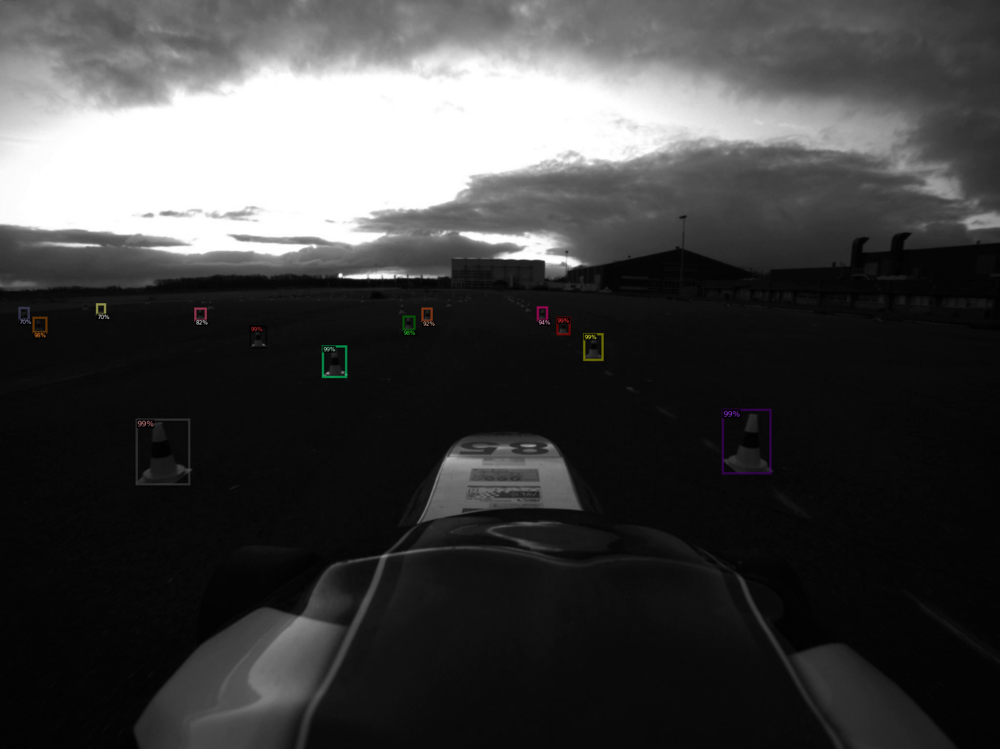

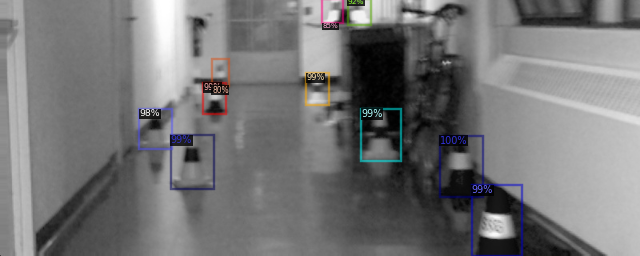

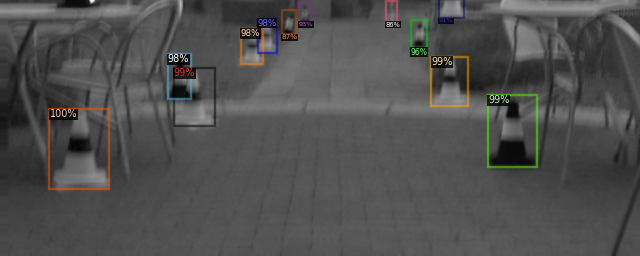

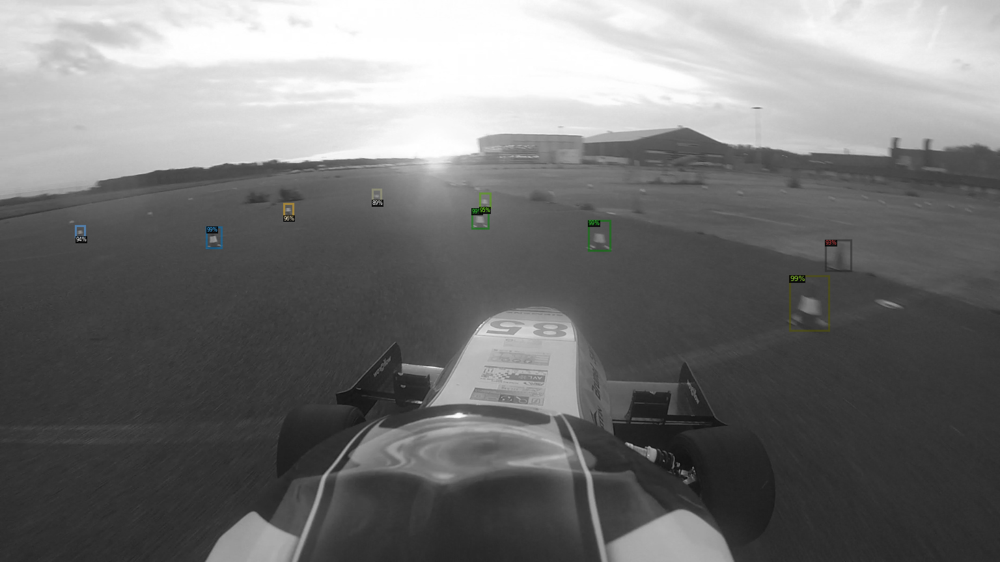

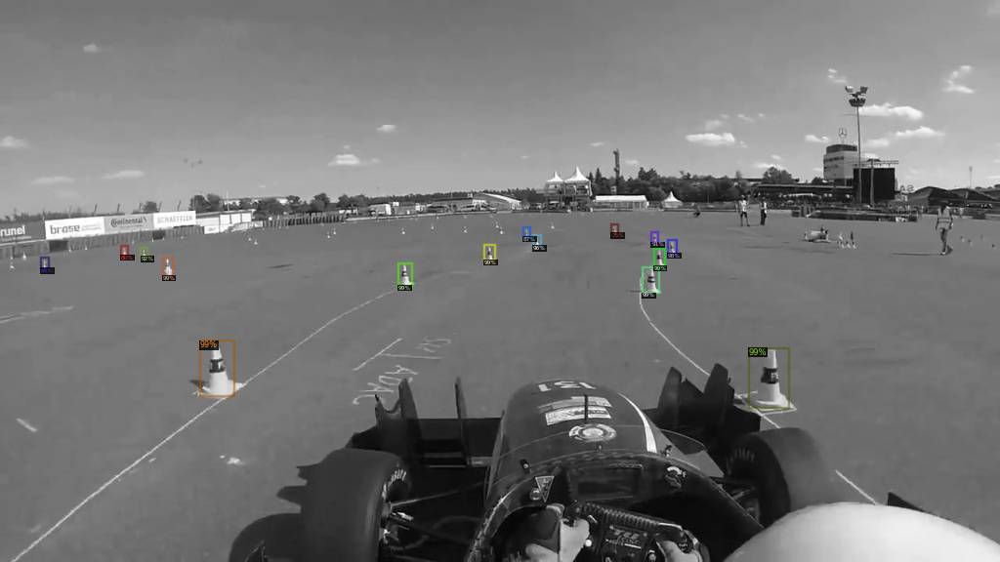

In [ ]:
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/drive/My Drive/yolov/json_dataset/test/images/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])
